In [1]:
import numpy as np
import matplotlib.pyplot as plt
import math

# Bandpass

In [2]:
w_bp_s1 = math.tan((1/15)*math.pi)
w_bp_p1 = math.tan((9/120)*math.pi)
w_bp_p2 = math.tan((44/120)*math.pi)
w_bp_s2 = math.tan((45/120)*math.pi)
w_not_bp=np.sqrt(w_bp_p1 * w_bp_p2)
w_not_bp

0.7343199040794354

In [3]:
B_bp = w_bp_p2 - w_bp_p1
B_bp

2.005958014824099

In [4]:
def transform_BP(x):
    return (x**2-w_not_bp**2)/(B_bp*x)

In [5]:
w_bp_ls1 = transform_BP(w_bp_s1)
w_bp_ls2 = transform_BP(w_bp_s2)
w_bp_lp1 = transform_BP(w_bp_p1)
w_bp_lp2 = transform_BP(w_bp_p2)
w_bp_ls = min(abs(w_bp_ls1),abs(w_bp_ls2))

In [6]:
freq_bp=np.array([w_bp_s1, w_bp_p1, w_bp_p2, w_bp_s2])
freq_bp_lp = np.array([w_bp_ls1, w_bp_lp1, w_bp_lp2, w_bp_ls2])

In [7]:
tol_bp_1 = 0.922 #math.sqrt(0.85)
tol_bp_2 = 0.15 

In [8]:
#eqn1
D1 = 1/(tol_bp_1**2) - 1
D2 = 1/(tol_bp_2**2) - 1
D1, D2

(0.1763543367478977, 43.44444444444444)

In [9]:
N = 0.5 * (math.log(D2 / D1) / math.log(w_bp_ls))
N = math.ceil(N)
print(N)

32


In [10]:
w_c1 = w_bp_ls / (D2 ** (1 / (2 * N)))
w_c2 = 1 / (D1 ** (1 / (2 * N)))
print(w_c1, w_c2)

1.0296742631485278 1.0274843519049595


In [11]:
# selecting
w_bp_c = (w_c2 + w_c1)/2 #average of the two
N_bp = N
print("BP", N_bp, w_bp_c)

BP 32 1.0285793075267438


In [12]:
def h_bp(w):
    return 1 / ( 1 + ((w / w_bp_c) ** (2 * N_bp)) ) 

# BAND STOP

In [13]:
# band stop
w_bs_p1 = math.tan((15/120)*math.pi)
w_bs_s1 = math.tan((16/120)*math.pi)
w_bs_s2 = math.tan((37/120)*math.pi)
w_bs_p2 = math.tan((38/120)*math.pi)
w_not_bs = math.sqrt(w_bs_p1 * w_bs_p2)
B_bs = w_bs_p2 - w_bs_p1
print("B" , B_bs, "w_not", w_not_bs**2)
def transform_BS(x):
    return (B_bs*x)/(w_not_bs**2 - x**2)

w_bs_ls1 = transform_BS(w_bs_s1)
w_bs_ls2 = transform_BS(w_bs_s2)
w_bs_lp1 = transform_BS(w_bs_p1)
w_bs_lp2 = transform_BS(w_bs_p2)
freq_bs_lp = np.array([w_bs_ls2, w_bs_lp2, w_bs_lp1, w_bs_ls1])
print(freq_bs_lp)
w_bs_ls = min(abs(w_bs_ls1),abs(w_bs_ls2))
w_bs_p1*300000/np.pi, w_bs_p2*300000/np.pi, w_bs_s1*300000/np.pi, w_bs_s2*300000/np.pi

B 1.1256514014414876 w_not 0.6378329522351553
[-1.10722868 -1.          1.          1.14005303]


(39554.48156842871, 147046.27241106803, 42516.207643895665, 138943.12749393412)

In [14]:
pass_tol = math.sqrt(0.85)
pass_tol

0.9219544457292888

In [15]:
stop_tol = 0.15

In [16]:
D2 = 1/(stop_tol**2) - 1
D1 = 1/(pass_tol**2) - 1

In [17]:
# solving the two -> 
N  = 0.5 * (math.log(D1 / D2) / math.log(1 / w_bs_ls))
N = math.ceil(N)
N_bs = N
N_bs

28

In [18]:
wc1 = 1 / (D1 ** (1 / (2*N))) 
wc2 = w_bs_ls / (D2 ** (1 / (2*N)))
print(f" {wc1} <= wc <= {wc2}")

 1.031459736510375 <= wc <= 1.0351147603220336


In [19]:
w_bs_c = (wc1 + wc2)/2
w_bs_c

1.0332872484162043

[-5.        -4.9989999 -4.9979998 ...  4.9979998  4.9989999  5.       ]


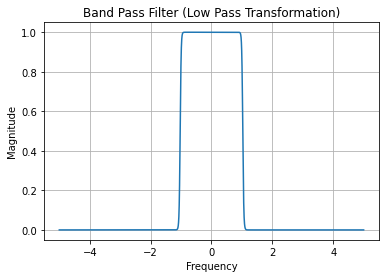

In [20]:
import matplotlib.pyplot as plt
import numpy as np
x_bp_lp= np.linspace(-5, 5, 10000)
print(x_bp_lp)
y_bp_lp = h_bp(x_bp_lp)
plt.plot(x_bp_lp, y_bp_lp)
plt.xlabel('Frequency')
plt.ylabel('Magnitude')
plt.title('Band Pass Filter (Low Pass Transformation)')
plt.grid()
plt.savefig('Band Pass Filter (Low Pass Transformation).png')
plt.show()

[1.00000000e-03 1.04999050e-03 1.09998100e-03 ... 4.99990002e+00
 4.99995001e+00 5.00000000e+00]


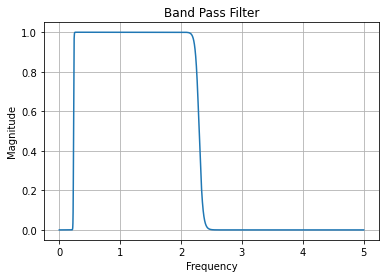

In [21]:
def h_bp_hp(w):
    return h_bp(transform_BP(w))

x_bp_hp = np.linspace(0.001, 5, 100000)
print(x_bp_hp)
y_bp_hp = h_bp_hp(x_bp_hp)
plt.plot(x_bp_hp, y_bp_hp)
plt.xlabel('Frequency')
plt.ylabel('Magnitude')
plt.title('Band Pass Filter')
plt.grid()
plt.savefig('Band Pass Filter.png')
plt.show()

0.8622057757215102


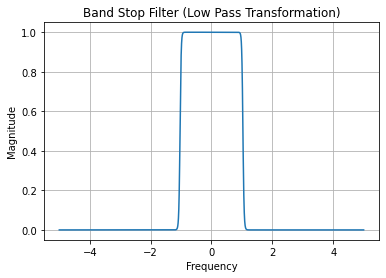

In [22]:
def h_bs(w):
    return 1 / ( 1 + ((w / w_bs_c) ** (2 * N_bs)) )
print(h_bs(-1))
x_bs_lp= np.linspace(-5, 5, 10000)
y_bs_lp = h_bs(x_bs_lp)
plt.plot(x_bs_lp, y_bs_lp)
plt.xlabel('Frequency')
plt.ylabel('Magnitude')
plt.title('Band Stop Filter (Low Pass Transformation)')
plt.grid()
plt.savefig('Band Stop Filter (Low Pass Transformation).png')
plt.show()


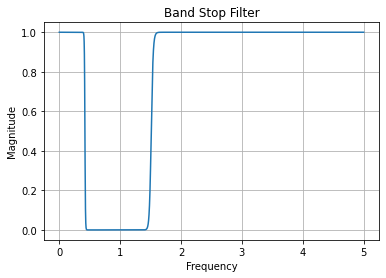

In [23]:
x_bs_hp = np.linspace(0.001, 5, 100000)
y_bs_hp = h_bs(transform_BS(x_bs_hp))
plt.plot(x_bs_hp, y_bs_hp)
plt.xlabel('Frequency')
plt.ylabel('Magnitude')
plt.title('Band Stop Filter')
plt.grid()
plt.savefig('Band Stop Filter.png')

plt.show()



In [24]:
def H_hp(w):
    a = h_bp(transform_BP(w))
    b = h_bs(transform_BS(w))
    return a * b

In [25]:
w_bp_s1 = math.tan((8/120)*math.pi)
print(w_bp_s1)
w_bp_p1 = math.tan((9/120)*math.pi)
print(w_bp_p1)
w_bp_p2 = math.tan((44/120)*math.pi)
print(w_bp_p2)
w_bp_s2 = math.tan((45/120)*math.pi)
print(w_bp_s2)

w_bs_p1 = math.tan((15/120)*math.pi)
print(w_bs_p1)
w_bs_s1 = math.tan((16/120)*math.pi)
print(w_bs_s1)
w_bs_s2 = math.tan((37/120)*math.pi)
print(w_bs_s2)
w_bs_p2 = math.tan((38/120)*math.pi)
print(w_bs_p2)
x_sc = np.array([w_bp_s1, w_bp_p1, w_bp_p2, w_bp_s2, w_bs_s1, w_bs_p1, w_bs_p2, w_bs_s2])
x_sc_= 2*np.arctan(x_sc)
y_sc = np.sqrt(H_hp(x_sc))
y_hp = np.sqrt(y_bp_hp * y_bs_hp)
from plotly import graph_objects as go

fig = go.Figure(data=go.Scatter(x=x_bp_hp, y=y_hp,fill = 'tonextx',name = 'Overall analog Filter Response'), layout=go.Layout(title="Magnitude Response of Bandpass and Bandstop Filter"))
fig.add_trace(go.Scatter(x=x_sc, y=y_sc, mode='markers', marker=dict(color='blue', size=5, opacity=0.5), name='Critical Frequencies'))
fig.show()


0.2125565616700221
0.24007875908011603
2.246036773904215
2.414213562373095
0.41421356237309503
0.4452286853085361
1.4550090286724449
1.5398649638145827


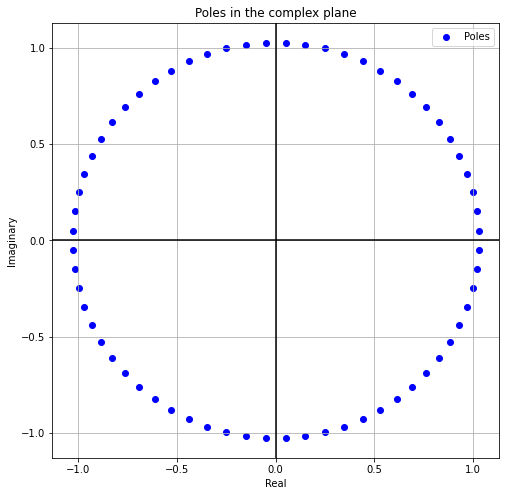

In [26]:
import cmath
i = cmath.sqrt(-1)
s_bp = np.array([w_bp_c * i * cmath.exp(((2*k+1) * i * cmath.pi) / (2*N_bp))  for k in range(2*N_bp)])
# print(s_bp)

# extract real and imaginary parts of the poles
real = [pole.real for pole in s_bp]
imag = [pole.imag for pole in s_bp]

plt.figure(figsize=(8, 8))
plt.scatter(real, imag, color='blue', label='Poles')
plt.xlabel('Real')
plt.ylabel('Imaginary')
plt.title('Poles in the complex plane')
plt.grid(True)
plt.axvline(x=0, color='k')
plt.axhline(y=0, color='k')
plt.legend()
plt.show()




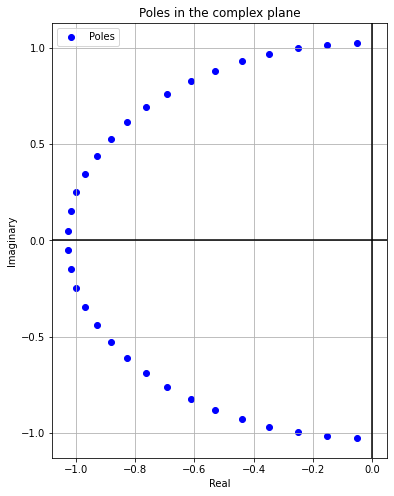

In [27]:

s_bp_lhp = np.array([w_bp_c * i * cmath.exp(((2*k+1) * i * cmath.pi) / (2*N_bp))  for k in range(N_bp)])
# print(s_bp)

# extract real and imaginary parts of the poles
real = [pole.real for pole in s_bp_lhp]
imag = [pole.imag for pole in s_bp_lhp]

plt.figure(figsize=(6, 8))
plt.scatter(real, imag, color='blue', label='Poles')
plt.xlabel('Real')
plt.ylabel('Imaginary')
plt.title('Poles in the complex plane')
plt.grid(True)
plt.axvline(x=0, color='k')
plt.axhline(y=0, color='k')
plt.legend()
plt.show()


In [28]:
def plot_poles(s,title,z,Zero):
    real = [pole.real for pole in s]
    imag = [pole.imag for pole in s]

    plt.figure(figsize=(6, 8))
    plt.scatter(real, imag, color='blue', marker = 'x',label='Poles')
    if Zero:
        z_real = [pole.real for pole in z]
        z_imag = [pole.imag for pole in z]
        plt.scatter(z_real,z_imag, color='red', marker = 'o',label='Zero')
    plt.xlabel('Real')
    plt.ylabel('Imaginary')
    plt.title(title)
    plt.grid(True)
    plt.axvline(x=0, color='k')
    plt.axhline(y=0, color='k')
    plt.legend()
    plt.savefig(title + ".png")

    plt.show()

# plot_poles(s_bp_lhp, "Poles of Bandpass Filter", 0, False)

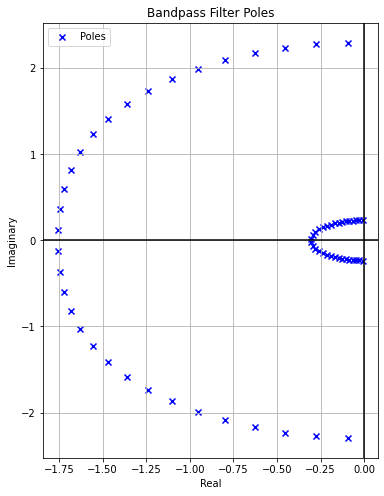

In [29]:

def solve_complex_quadratic(a, b, c):
    # calculate the discriminant
    d = (b**2) - (4*a*c)

    # find two solutions
    sol1 = (-b-cmath.sqrt(d))/(2*a)
    sol2 = (-b+cmath.sqrt(d))/(2*a)

    return sol1, sol2

s_bp_h = np.array([solve_complex_quadratic(1, -B_bp*sl, w_not_bp**2) for sl in s_bp_lhp])
plot_poles(s_bp_h, 'Bandpass Filter Poles', 0, False)
s_bp_h = s_bp_h.reshape(-1)

In [30]:
prod_roots_lhp = np.prod(s_bp_lhp)
print(prod_roots_lhp)

(2.4638204779685737-4.954370247389761e-15j)


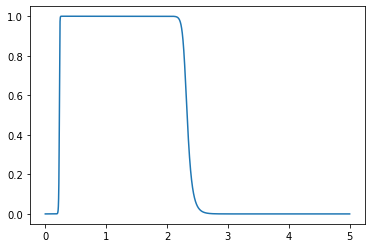

In [31]:
def transfer_func_HP_BP(s):
    return (prod_roots_lhp.real * ((B_bp*s)**N_bp) ) / np.prod(s - s_bp_h)
x_bp_hp = np.linspace(0.001, 5, 100000)
y_bp_hp = [abs(transfer_func_HP_BP(i*x)) for x in x_bp_hp]
plt.plot(x_bp_hp, y_bp_hp)

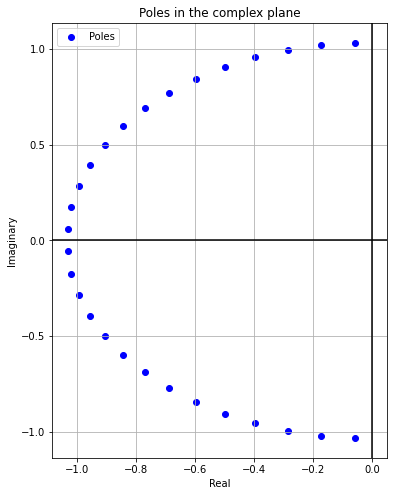

In [32]:
# Band stop
s_bs_lhp = np.array([w_bs_c * i * cmath.exp(((2*k+1) * i * cmath.pi) / (2*N_bs))  for k in range(N_bs)])
# print(s_bp)

# extract real and imaginary parts of the poles
real = [pole.real for pole in s_bs_lhp]
imag = [pole.imag for pole in s_bs_lhp]

plt.figure(figsize=(6, 8))
plt.scatter(real, imag, color='blue', label='Poles')
plt.xlabel('Real')
plt.ylabel('Imaginary')
plt.title('Poles in the complex plane')
plt.grid(True)
plt.axvline(x=0, color='k')
plt.axhline(y=0, color='k')
plt.legend()
plt.show()


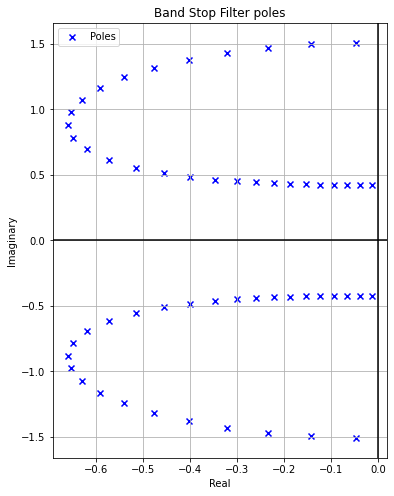

In [33]:
s_bs_h = np.array([solve_complex_quadratic(1, -B_bs/sl, w_not_bs**2) for sl in s_bs_lhp])
s_bs_h = s_bs_h.reshape(-1)
prod_bs_lhp = np.prod(s_bs_lhp)
plot_poles(s_bs_h, "Band Stop Filter poles", 0, False)

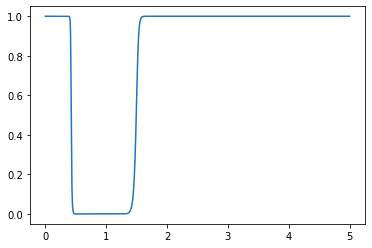

In [34]:
def transfer_func_HP_BS(s):
    prod_a = (s**2 + w_not_bs**2)**(N_bs)
    prod_b = np.prod(s - s_bs_h) * ((-1)**N_bs)
    return prod_a / prod_b

x_bs_hp = np.linspace(0.001, 5, 100000)
y_bs_hp = [abs(transfer_func_HP_BS(i*x)) for x in x_bs_hp]
plt.plot(x_bs_hp, y_bs_hp)

In [35]:
def transfer_net_analog(s):
    return transfer_func_HP_BP(s) * transfer_func_HP_BS(s)

x_hp = np.linspace(0.001, 5, 100000)
y_hp = np.array([abs(transfer_net_analog(i*x)) for x in x_hp])
# plt.plot(x_hp, y_hp)

fig = go.Figure(data=go.Scatter(x=x_hp, y=y_hp,name='Overall Analog Filter Response',fill='tonextx'), layout=go.Layout(title="Magnitude Response of Bandpass and Bandstop Filter"))
fig.add_trace(go.Scatter(x=x_sc, y=y_sc, mode='markers', marker=dict(color='red'),name='Critical Frequencies'))
fig.show()

In [36]:
x_ = 2 * np.arctan(np.linspace(0.001, 5, 100000))
y__ = np.array([y_hp, y_hp, y_hp, y_hp, y_hp, y_hp, y_hp, y_hp, y_hp, y_hp]).reshape(-1) 
# plt.plot(x_hp, y_hp)

fig = go.Figure(data=go.Scatter(x=x_, y=y__,fill='tonextx',name='Overall IIR Filter Response'), layout=go.Layout(title="Magnitude Response of Bandpass and Bandstop Filter"))
fig.add_trace(go.Scatter(x=x_sc_, y=y_sc, mode='markers', name = 'Critical points',marker=dict(color='red')))
fig.show()

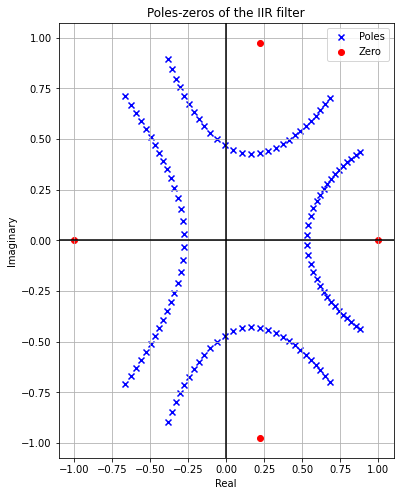

In [37]:
def bilinear_transform(s):
    return (s+1)/(1-s)


s_bp_iir = np.array([bilinear_transform(sl) for sl in s_bp_h])
s_bs_iir = np.array([bilinear_transform(sl) for sl in s_bs_h])
all_poles = np.concatenate((s_bp_iir, s_bs_iir))
z = [1,-1,bilinear_transform(i*w_not_bs),bilinear_transform(-i*w_not_bs)]
plot_poles(all_poles,'Poles-zeros of the IIR filter', z, True)


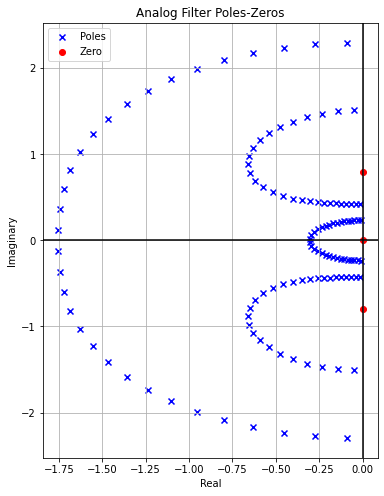

In [38]:
all_analog_poles = np.concatenate((s_bp_h, s_bs_h))
plot_poles(all_analog_poles, 'Analog Filter Poles-Zeros', [0,i*w_not_bs,-i*w_not_bs], True)

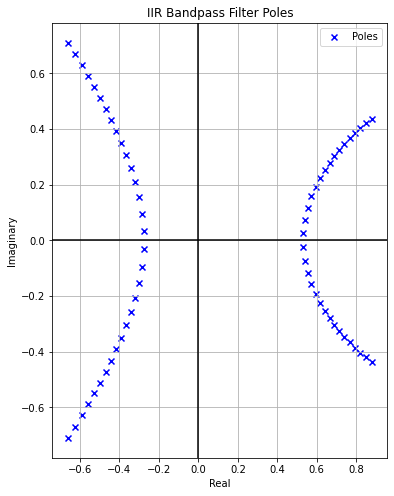

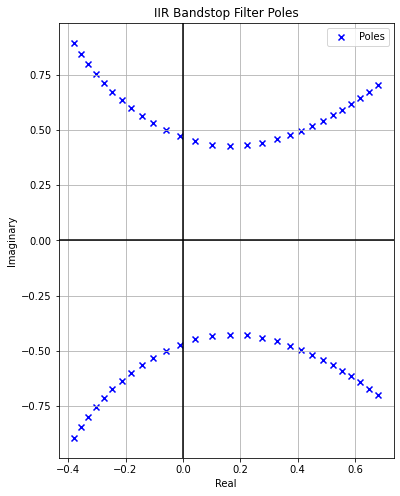

In [39]:
plot_poles(s_bp_iir, 'IIR Bandpass Filter Poles', 0, False)
plot_poles(s_bs_iir, 'IIR Bandstop Filter Poles', 0, False)

In [40]:
def I0(x):
    return np.i0(x)

def FFT(x):
    return np.fft.rfft(x,n=1000)

def kaiser_window(N, beta):
    n = np.arange(0, N)
    return I0(beta * np.sqrt(1 - ((2*n - N + 1) / (N - 1))**2)) / I0(beta)

In [71]:
import numpy as np
import matplotlib.pyplot as plt


# Filter Specification Declaration
delta_stop 		= 0.15
delta_pass    	= (0.15)

analog_freq_bp = np.array([40,45,220,225])*1000
digital_freq_bp = analog_freq_bp*np.pi/300000

# Kaiser window parameters
del_omega1_bp = digital_freq_bp[3] - digital_freq_bp[2]
del_omega2_bp = digital_freq_bp[1] - digital_freq_bp[0]
del_omega_bp  = min(abs(del_omega1_bp),abs(del_omega2_bp))
A 		   = -20*np.log10(delta_stop)

if(A<21):
    alpha=0
elif(A<=50):
    alpha=0.5842*(A-21)**0.4+0.07886(A-21)
else:
    alpha=0.1102(A-8.7)

order_offset = 5
N_critical = np.ceil((A-8)/(2*2.285*del_omega_bp))
N = N_critical + order_offset

# Cutoff frequency calculation ideal impulse response
omega_c1 = (digital_freq_bp[1]+digital_freq_bp[0])*0.5
omega_c2 = (digital_freq_bp[3]+digital_freq_bp[2])*0.5

N,A,alpha,omega_c1,omega_c2
digital_freq_bp*300000/np.pi
del_omega1_bp, del_omega2_bp, del_omega_bp, N, A, alpha, omega_c1, omega_c2,alpha/N

(0.05235987755982974,
 0.052359877559829904,
 0.05235987755982974,
 41.0,
 16.478174818886377,
 0,
 0.4450589592585541,
 2.3300145514124297,
 0.0)

In [72]:
# Obtain the ideal bandpass impulse response
iterable   = ((np.sin(omega_c2*k)-np.sin(omega_c1*k))/(np.pi*k) for k in range(int(-N),int(N+1)))
h_ideal_bp    = np.fromiter(iterable,float)
h_ideal_bp[int(N)] = ((omega_c2-omega_c1)/np.pi)
beta       = alpha/N
beta


/home/harshraj/anaconda3/envs/drlnd/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning:

invalid value encountered in double_scalars



0.0

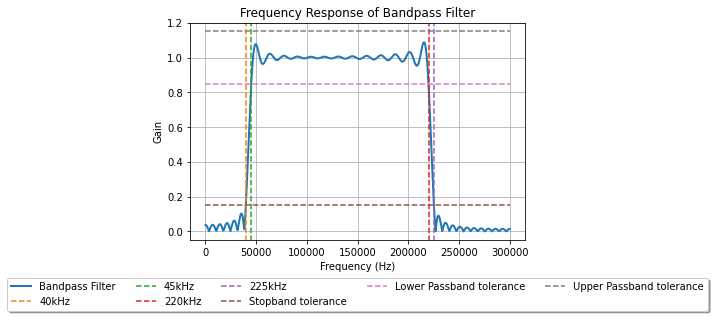

In [70]:

# Generate Kaiser window 
h_kaiser_bp = kaiser_window(2*N+1,beta)
h_org_bp    = h_ideal_bp*h_kaiser_bp


# Plot Frequency response
plt.figure(2)
plt.clf()
plt.grid(True)
h_bp= FFT(h_org_bp)
freq = np.linspace(0,np.pi,len(h_bp))
plt.plot((freq/np.pi)*300000, np.absolute(h_bp), linewidth=2, label='Bandpass Filter')
plt.plot((40000,40000),(-0.1,1.2), scaley=False,label='40kHz',linestyle='dashed')
plt.plot((45000,45000),(-0.1,1.2), scaley=False,label='45kHz',linestyle='dashed')
plt.plot((220000,220000),(-0.1,1.2), scaley=False,label='220kHz',linestyle='dashed')
plt.plot((225000,225000),(-0.1,1.2), scaley=False,label='225kHz',linestyle='dashed')
plt.plot((0,300000),(0.15,0.15), scaley=False,label='Stopband tolerance',linestyle='dashed')
plt.plot((0,300000),(0.85,0.85), scaley=False,label='Lower Passband tolerance',linestyle='dashed')
plt.plot((0,300000),(1.15,1.15), scaley=False,label='Upper Passband tolerance',linestyle='dashed')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Gain')
plt.title('Frequency Response of Bandpass Filter')
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=5)
plt.ylim(-0.05, 1.2)
plt.savefig('FIR Bandpass Filter.png')

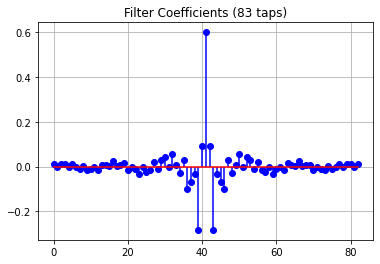

In [58]:
y = np.linspace(0,h_org_bp.size-1,h_org_bp.size)
plt.stem(y,h_org_bp,linefmt='b-', markerfmt='bo', basefmt='r-')
plt.title('Filter Coefficients (%d taps)' % (2*N+1))
plt.grid(True)
plt.savefig('FIR Bandpass Filter Coefficients.png')

In [76]:
# Filter Specification Declaration
delta_stop 		= 0.15
delta_pass    	= 0.15

analog_freq_bs = np.array([75,80,185,190])*1000
digital_freq_bs = analog_freq_bs*np.pi/300000

# Kaiser window parameters
del_omega1_bs = digital_freq_bs[3] - digital_freq_bs[2]
del_omega2_bs = digital_freq_bs[1] - digital_freq_bs[0]
del_omega_bs  = min(abs(del_omega1_bs),abs(del_omega2_bs))
A 		   = -20*np.log10(delta_stop)

if(A<21):
    alpha=0
elif(A<=50):
    alpha=0.5842*(A-21)**0.4+0.07886(A-21)
else:
    alpha=0.1102(A-8.7)

order_offset = 5
N_critical = np.ceil((A-8)/(2*2.285*del_omega_bs))
N = N_critical + order_offset

# Cutoff frequency calculation ideal impulse response
omega_c1_bs = (digital_freq_bs[1]+digital_freq_bs[0])*0.5
omega_c2_bs = (digital_freq_bs[3]+digital_freq_bs[2])*0.5

N,A,alpha,omega_c1_bs,omega_c2_bs
digital_freq_bs*300000/(np.pi), omega_c1_bs, omega_c2_bs
N


41.0

In [75]:
# Obtain the ideal bandpass impulse response
iterable   = ((np.sin(omega_c1_bs*k)-np.sin(omega_c2_bs*k))/(np.pi*k) for k in range(int(-N),int(N+1)))
h_ideal_bs    = np.fromiter(iterable,float)
h_ideal_bs[int(N)] = ((omega_c1_bs-omega_c2_bs)/np.pi)+1
beta_bs       = alpha/N
del_omega1_bs, del_omega2_bs, del_omega_bs, N, A, alpha, omega_c1_bs, omega_c2_bs,alpha/N

/home/harshraj/anaconda3/envs/drlnd/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning:

invalid value encountered in double_scalars



(0.05235987755982974,
 0.05235987755982996,
 0.05235987755982974,
 41.0,
 16.478174818886377,
 0,
 0.8115781021773633,
 1.9634954084936207,
 0.0)

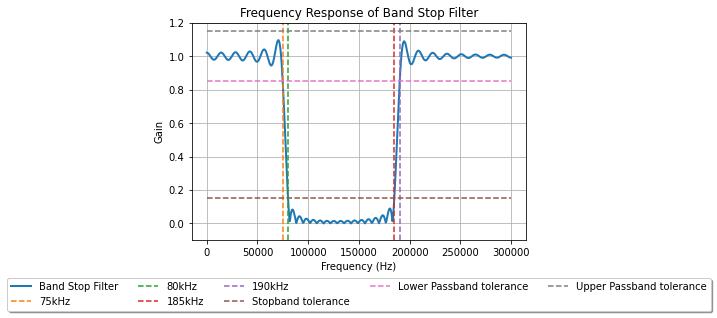

In [66]:
# Generate Kaiser window 
h_kaiser_bs=kaiser_window(2*N+1,beta_bs)
h_org_bs=h_ideal_bs*h_kaiser_bs

# Plot Frequency response
plt.figure(2)
plt.clf()
plt.grid(True)
h_bs = FFT(h_org_bs)
freq = np.linspace(0,np.pi,len(h_bs))
plt.plot((freq/np.pi)*300000, np.absolute(h_bs), linewidth=2,label='Band Stop Filter')
plt.plot((75000,75000),(-0.1,1.2), scaley=False,label='75kHz',linestyle='dashed')
plt.plot((80000,80000),(-0.1,1.2), scaley=False,label='80kHz',linestyle='dashed')
plt.plot((185000,185000),(-0.1,1.2), scaley=False,label='185kHz',linestyle='dashed')
plt.plot((190000,190000),(-0.1,1.2), scaley=False,label='190kHz',linestyle='dashed')
plt.plot((0,300000),(0.15,0.15), scaley=False,label='Stopband tolerance',linestyle='dashed')
plt.plot((0,300000),(0.85,0.85), scaley=False,label='Lower Passband tolerance',linestyle='dashed')
plt.plot((0,300000),(1.15,1.15), scaley=False,label='Upper Passband tolerance',linestyle='dashed')
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=5)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Gain')
plt.title('Frequency Response of Band Stop Filter')
plt.ylim(-0.1, 1.2)
plt.savefig('FIR Band Stop Filter.png')

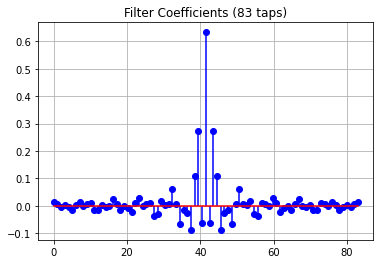

In [57]:
y = np.linspace(0,h_org_bs.shape[0],h_org_bs.shape[0])
plt.stem(y,h_org_bs,linefmt='b-', markerfmt='bo', basefmt='r-')
plt.title('Filter Coefficients (%d taps)' % (2*N+1))
plt.grid(True)
plt.savefig('FIR Band Stop Filter Coefficients.png')

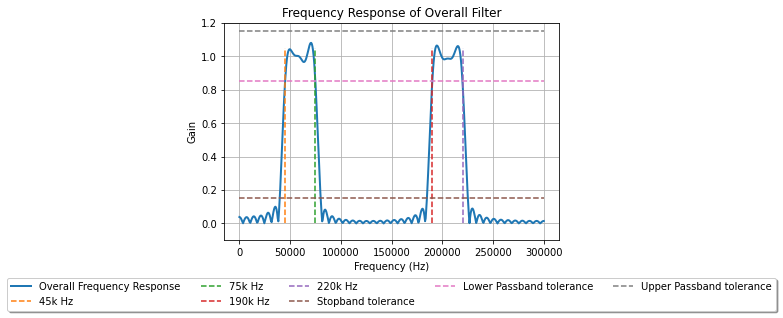

In [67]:
h_final = h_bp * h_bs
# Plot Frequency response
plt.grid(True)
plt.plot((freq/np.pi)*300000, np.absolute(h_final), linewidth=2,label='Overall Frequency Response')
plt.plot((45000, 45000), (0, 1.05), scaley = False, label='45k Hz', linestyle='dashed')
plt.plot((75000, 75000), (0, 1.05), scaley = False, label='75k Hz', linestyle='dashed')
plt.plot((190000, 190000), (0, 1.05), scaley = False, label='190k Hz', linestyle='dashed')
plt.plot((220000, 220000), (0, 1.05), scaley = False, label='220k Hz', linestyle='dashed')
plt.plot((0,300000),(0.15,0.15), scaley=False,label='Stopband tolerance',linestyle='dashed')
plt.plot((0,300000),(0.85,0.85), scaley=False,label='Lower Passband tolerance',linestyle='dashed')
plt.plot((0,300000),(1.15,1.15), scaley=False,label='Upper Passband tolerance',linestyle='dashed')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Gain')
plt.title('Frequency Response of Overall Filter')
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=5)
plt.ylim(-0.1, 1.2)
plt.savefig('FIR Overall Filter.png')

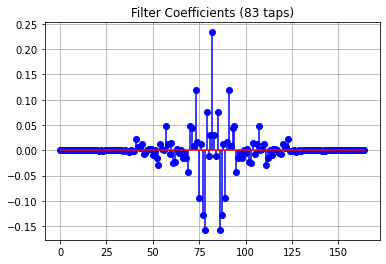

In [56]:
h_final_n = np.convolve(h_org_bp,h_org_bs)
y = np.linspace(0,h_final_n.size-1,h_final_n.size)
plt.stem(y,h_final_n,linefmt='b-', markerfmt='bo', basefmt='r-')
plt.title('Filter Coefficients (%d taps)' % (2*N+1))
plt.grid(True)
plt.savefig('FIR Overall Filter Coefficients.png')
